In [1]:
%load_ext autoreload
%autoreload 2
%env CUDA_LAUNCH_BLOCKING=1

env: CUDA_LAUNCH_BLOCKING=1


In [2]:
from main import main

In [ ]:
import torch
from torch import nn, optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from torchvision import transforms, models
from matplotlib import pyplot as plt

from add_channel import AddChannel
from dataset import IMDbFacialDataset, NUM_AGE_BUCKETS
from trainer import Trainer

BATCH_SIZE = 500
DATA_LOADER_NUM_WORKERS = 5

if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

print(f'Using device {device}')

model = torch.load('models/model.pt')

val_transform = transforms.Compose([
    AddChannel(),
    transforms.ToPILImage(),
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])
test_dataset = IMDbFacialDataset('imdb_crop', val_transform)
loader_test = DataLoader(
    test_dataset,
    batch_size=1,
    num_workers=DATA_LOADER_NUM_WORKERS,
    sampler=sampler.SubsetRandomSampler(range(0, 500))
)


In [ ]:
def get_age_range(range):
    start = range * 5
    return f'[{start}, {start + 4}]'

model.eval()
transform = transforms.ToPILImage()
with torch.no_grad():
    for x, y, f in loader_test:
        x = x.to(device=device)
        y = y.to(device=device)
        scores = model(x)
        _, preds = scores.max(1)
        predicted_age = preds.cpu().numpy()[0]
        actual_age = y.cpu().numpy()[0]
        image = io.imread(f[0])
        plt.imshow(image)
        plt.show()
        print('-' * 50)

In [ ]:
main()

Using device cuda
----------
Epoch 0
----------
Iteration 0, training loss = 1.2735
Val Loss: 2.3046358823776245
Got 1205 / 4600 correct (26.195652173913043%)

Iteration 100, training loss = 1.2986
Val Loss: 2.4341587035552315
Got 1118 / 4600 correct (24.304347826086957%)

Iteration 200, training loss = 1.3743
Val Loss: 2.428502005079518
Got 1111 / 4600 correct (24.15217391304348%)

Iteration 300, training loss = 1.2956
Val Loss: 2.41142359505529
Got 1146 / 4600 correct (24.913043478260867%)

Iteration 400, training loss = 1.2955
Val Loss: 2.46764702382295
Got 1131 / 4600 correct (24.586956521739133%)

Iteration 500, training loss = 1.3366
Val Loss: 2.4378274575523706
Got 1137 / 4600 correct (24.717391304347828%)

Iteration 600, training loss = 1.3363
Val Loss: 2.4954092450763867
Got 1111 / 4600 correct (24.15217391304348%)

Iteration 700, training loss = 1.3645
Val Loss: 2.3933535140493643
Got 1202 / 4600 correct (26.130434782608695%)

Iteration 800, training loss = 1.2514
Val Loss: 2

In [2]:
main()

Using device cuda
----------
Epoch 0
----------
Iteration 0, training loss = 3.2403
Val Loss: 2.826304264690565
Got 578 / 4600 correct (12.565217391304348%)

Iteration 100, training loss = 2.3714
Val Loss: 2.300834666127744
Got 855 / 4600 correct (18.586956521739133%)

Iteration 200, training loss = 2.4549
Val Loss: 2.2595231688540913
Got 791 / 4600 correct (17.195652173913043%)

Iteration 300, training loss = 2.3397
Val Loss: 2.3188031289888467
Got 724 / 4600 correct (15.739130434782608%)

Iteration 400, training loss = 2.3961
Val Loss: 2.2871427017709482
Got 816 / 4600 correct (17.739130434782606%)

Iteration 500, training loss = 2.4988
Val Loss: 2.2911744947018833
Got 1016 / 4600 correct (22.086956521739133%)

Iteration 600, training loss = 2.3690
Val Loss: 2.242384889851446
Got 978 / 4600 correct (21.26086956521739%)

Iteration 700, training loss = 2.3574
Val Loss: 2.2710676918859067
Got 1080 / 4600 correct (23.47826086956522%)

Iteration 800, training loss = 2.4470
Val Loss: 2.381

Iteration 800, training loss = 2.3030
Val Loss: 2.3201883409334267
Got 783 / 4600 correct (17.02173913043478%)

Iteration 900, training loss = 2.4141
Val Loss: 2.291361990182296
Got 739 / 4600 correct (16.065217391304348%)

Val Loss: 2.2770765760670537
Got 844 / 4600 correct (18.347826086956523%)
******************************
End of epoch 5 summary
Total samples: 450870
Training loss: 2.369703304739318, accuracy: 0.1692771752389824
Val loss: 2.2770765760670537, accuracy: 0.18347826086956523
******************************
----------
Epoch 6
----------
Iteration 0, training loss = 2.3983
Val Loss: 2.310464268145354
Got 732 / 4600 correct (15.91304347826087%)

Iteration 100, training loss = 2.3005
Val Loss: 2.2574506116949995
Got 854 / 4600 correct (18.565217391304348%)

Iteration 200, training loss = 2.2914
Val Loss: 2.3264757809431655
Got 651 / 4600 correct (14.152173913043478%)

Iteration 300, training loss = 2.2698
Val Loss: 2.238260165504787
Got 1064 / 4600 correct (23.1304347826086

Iteration 400, training loss = 2.2653
Val Loss: 2.214890101681585
Got 847 / 4600 correct (18.413043478260867%)

Iteration 500, training loss = 2.2002
Val Loss: 2.225829565006754
Got 945 / 4600 correct (20.543478260869566%)

Iteration 600, training loss = 2.2368
Val Loss: 2.230644651081251
Got 774 / 4600 correct (16.82608695652174%)

Iteration 700, training loss = 2.2790
Val Loss: 2.2298211636750596
Got 774 / 4600 correct (16.82608695652174%)

Iteration 800, training loss = 2.2325
Val Loss: 2.2222246812737505
Got 845 / 4600 correct (18.369565217391305%)

Iteration 900, training loss = 2.2770
Val Loss: 2.2307366910188096
Got 883 / 4600 correct (19.195652173913043%)

Val Loss: 2.231595189675041
Got 907 / 4600 correct (19.717391304347824%)
******************************
End of epoch 11 summary
Total samples: 450870
Training loss: 2.252544464035858, accuracy: 0.18916095548606027
Val loss: 2.231595189675041, accuracy: 0.19717391304347825
******************************
----------
Epoch 12
---

----------
Epoch 17
----------
Iteration 0, training loss = 2.2638
Val Loss: 2.213887131732443
Got 915 / 4600 correct (19.891304347826086%)

Iteration 100, training loss = 2.2258
Val Loss: 2.2060803537783413
Got 886 / 4600 correct (19.26086956521739%)

Iteration 200, training loss = 2.2394
Val Loss: 2.217172990674558
Got 920 / 4600 correct (20.0%)

Iteration 300, training loss = 2.2512
Val Loss: 2.227327497109123
Got 909 / 4600 correct (19.760869565217394%)

Iteration 400, training loss = 2.2596
Val Loss: 2.220905573471733
Got 769 / 4600 correct (16.717391304347824%)

Iteration 500, training loss = 2.2899
Val Loss: 2.2177438995112544
Got 1025 / 4600 correct (22.282608695652172%)

Iteration 600, training loss = 2.2485
Val Loss: 2.222827786984651
Got 728 / 4600 correct (15.82608695652174%)

Iteration 700, training loss = 2.2955
Val Loss: 2.2363298716752427
Got 701 / 4600 correct (15.239130434782608%)

Iteration 800, training loss = 2.2415
Val Loss: 2.23088640752046
Got 763 / 4600 correct

Iteration 900, training loss = 2.2136
Val Loss: 2.232626412225806
Got 787 / 4600 correct (17.108695652173914%)

Val Loss: 2.2323938349018926
Got 801 / 4600 correct (17.41304347826087%)
******************************
End of epoch 22 summary
Total samples: 450870
Training loss: 2.254361656803723, accuracy: 0.1881828464967729
Val loss: 2.2323938349018926, accuracy: 0.1741304347826087
******************************
----------
Epoch 23
----------
Iteration 0, training loss = 2.2620
Val Loss: 2.2320587220399277
Got 807 / 4600 correct (17.543478260869566%)

Iteration 100, training loss = 2.2573
Val Loss: 2.213388100914333
Got 806 / 4600 correct (17.52173913043478%)

Iteration 200, training loss = 2.3061
Val Loss: 2.2246865137763647
Got 758 / 4600 correct (16.47826086956522%)

Iteration 300, training loss = 2.2108
Val Loss: 2.212503573168879
Got 812 / 4600 correct (17.652173913043477%)

Iteration 400, training loss = 2.2248
Val Loss: 2.2089357220608257
Got 875 / 4600 correct (19.02173913043478

ChaLearn/images/train_1/000429.jpg



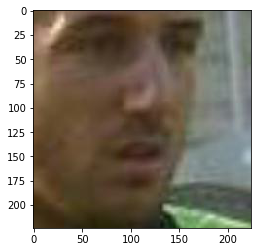

--------------------------------------------------
ChaLearn/images/train_1/000535.jpg



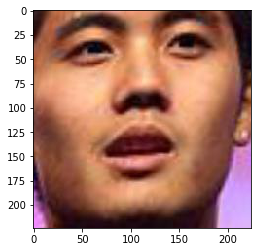

--------------------------------------------------
ChaLearn/images/train_1/001539.jpg



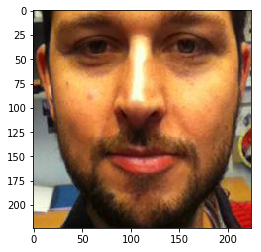

--------------------------------------------------
ChaLearn/images/train_1/001525.jpg



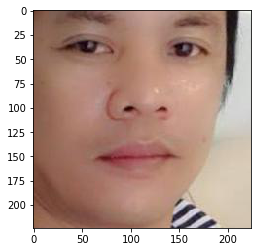

--------------------------------------------------
ChaLearn/images/train_1/001760.jpg



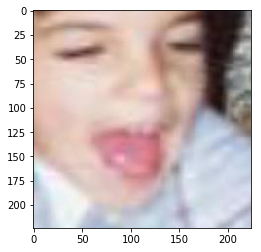

--------------------------------------------------
ChaLearn/images/train_1/000178.jpg



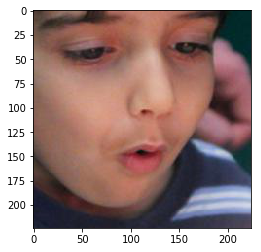

--------------------------------------------------
ChaLearn/images/train_1/000959.jpg



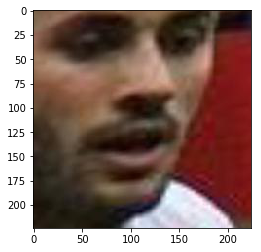

--------------------------------------------------
ChaLearn/images/train_1/001628.jpg



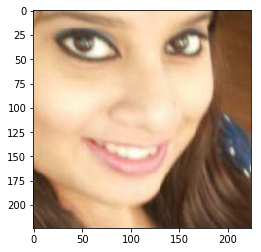

--------------------------------------------------
ChaLearn/images/train_1/000874.jpg



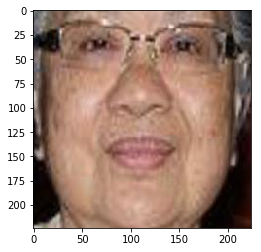

--------------------------------------------------
ChaLearn/images/train_1/001829.jpg



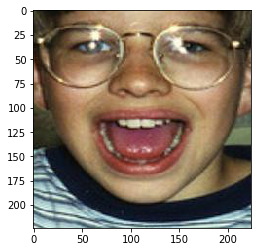

--------------------------------------------------
ChaLearn/images/train_1/001614.jpg



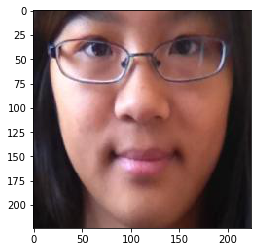

--------------------------------------------------
ChaLearn/images/train_1/001544.jpg



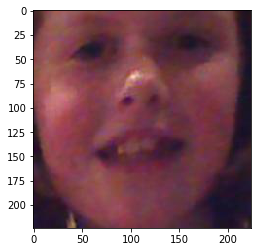

--------------------------------------------------
ChaLearn/images/train_1/001562.jpg



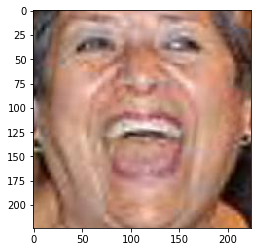

--------------------------------------------------
ChaLearn/images/train_1/000573.jpg



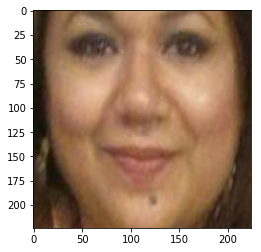

--------------------------------------------------
ChaLearn/images/train_1/001020.jpg



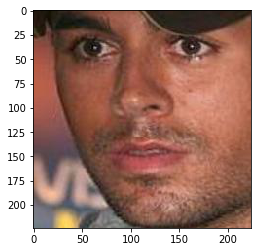

--------------------------------------------------
ChaLearn/images/train_1/001424.jpg



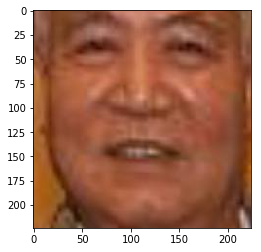

--------------------------------------------------
ChaLearn/images/train_1/001843.jpg



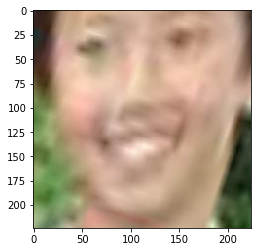

--------------------------------------------------
ChaLearn/images/train_1/000596.jpg



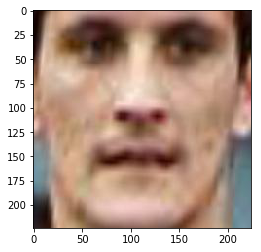

--------------------------------------------------
ChaLearn/images/train_1/000283.jpg



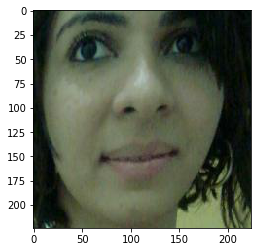

--------------------------------------------------
ChaLearn/images/train_1/000538.jpg



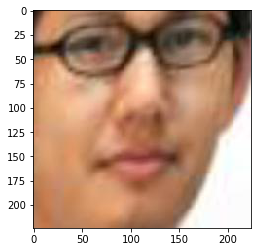

--------------------------------------------------
ChaLearn/images/train_1/000796.jpg



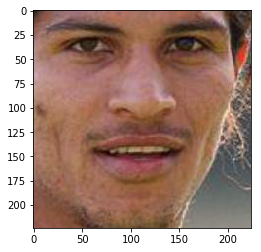

--------------------------------------------------
ChaLearn/images/train_1/000261.jpg



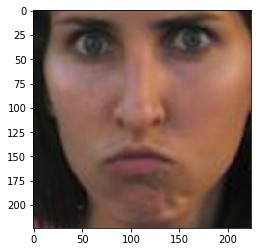

--------------------------------------------------
ChaLearn/images/train_1/000003.jpg



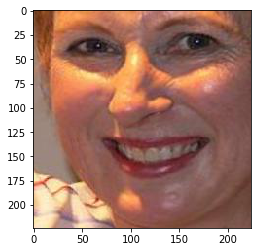

--------------------------------------------------
ChaLearn/images/train_1/001130.jpg



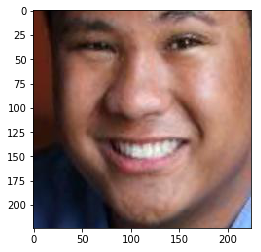

--------------------------------------------------
ChaLearn/images/train_1/000593.jpg



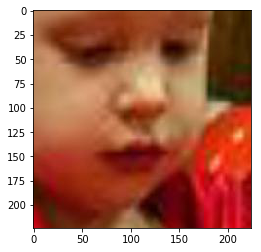

--------------------------------------------------
ChaLearn/images/train_1/001414.jpg



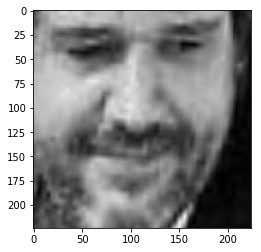

--------------------------------------------------
ChaLearn/images/train_1/000893.jpg



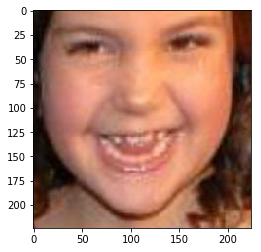

--------------------------------------------------
ChaLearn/images/train_1/000744.jpg



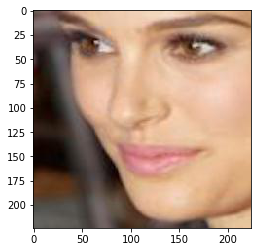

--------------------------------------------------
ChaLearn/images/train_1/000531.jpg



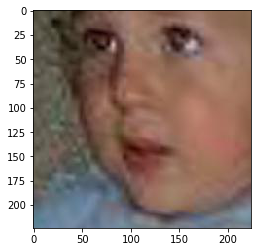

--------------------------------------------------
ChaLearn/images/train_1/000805.jpg



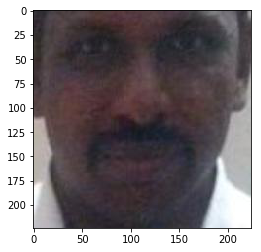

--------------------------------------------------
ChaLearn/images/train_1/001270.jpg



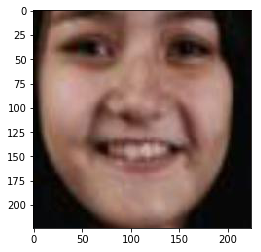

--------------------------------------------------
ChaLearn/images/train_1/001029.jpg



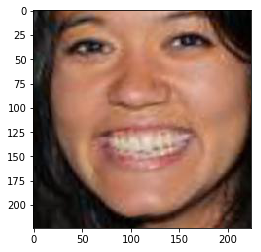

--------------------------------------------------
ChaLearn/images/train_1/000373.jpg



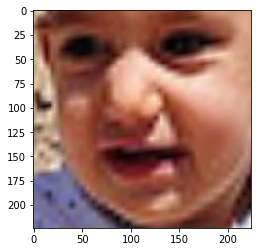

--------------------------------------------------
ChaLearn/images/train_1/001726.jpg



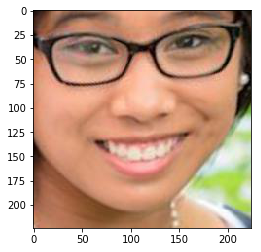

--------------------------------------------------
ChaLearn/images/train_1/001021.jpg



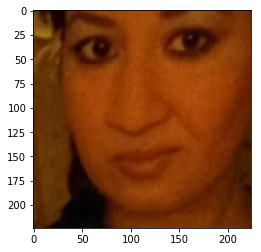

--------------------------------------------------
ChaLearn/images/train_1/001966.jpg



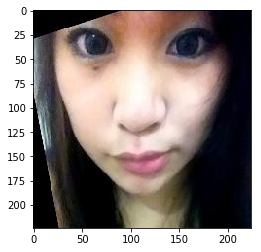

--------------------------------------------------
ChaLearn/images/train_1/000361.jpg



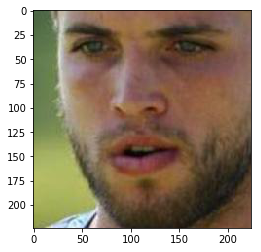

--------------------------------------------------
ChaLearn/images/train_1/000730.jpg



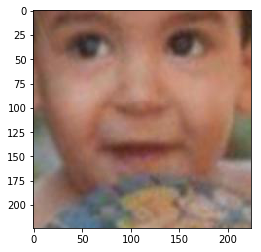

--------------------------------------------------
ChaLearn/images/train_1/000841.jpg



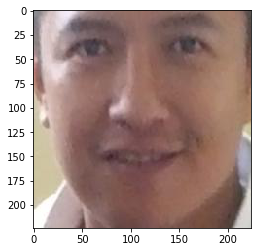

--------------------------------------------------
ChaLearn/images/train_1/002043.jpg



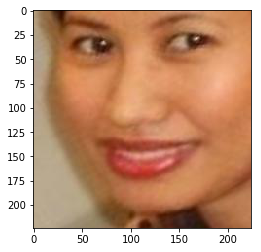

--------------------------------------------------
ChaLearn/images/train_1/001677.jpg



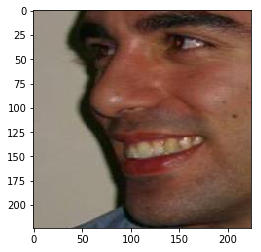

--------------------------------------------------
ChaLearn/images/train_1/000094.jpg



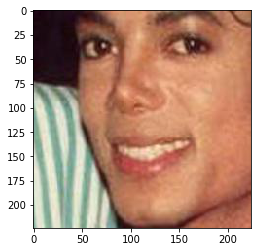

--------------------------------------------------
ChaLearn/images/train_1/002038.jpg



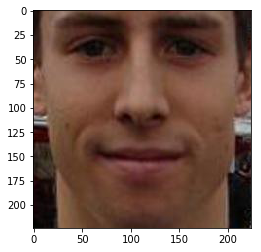

--------------------------------------------------
ChaLearn/images/train_1/000230.jpg



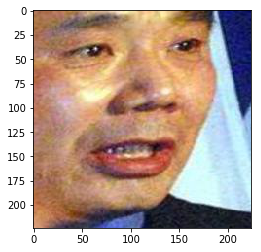

--------------------------------------------------
ChaLearn/images/train_1/001622.jpg



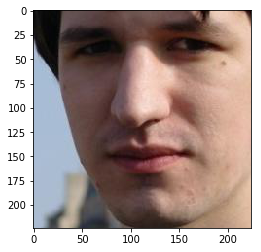

--------------------------------------------------
ChaLearn/images/train_1/000218.jpg



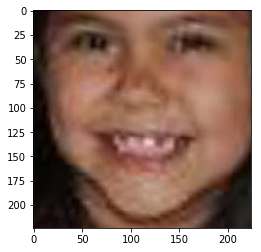

--------------------------------------------------
ChaLearn/images/train_1/000602.jpg



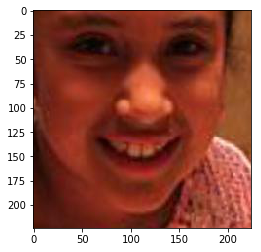

--------------------------------------------------
ChaLearn/images/train_1/000341.jpg



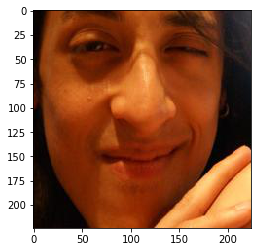

--------------------------------------------------
ChaLearn/images/train_1/002008.jpg



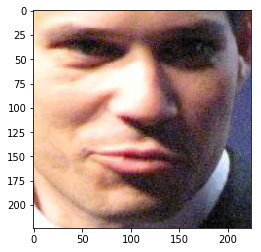

--------------------------------------------------
ChaLearn/images/train_1/001953.jpg



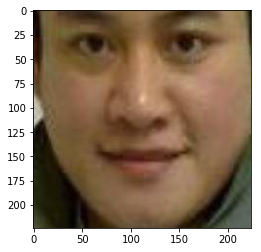

--------------------------------------------------
ChaLearn/images/train_1/001821.jpg



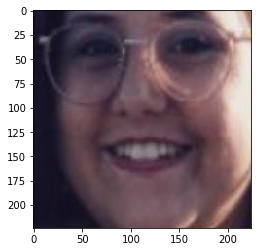

--------------------------------------------------
ChaLearn/images/train_1/000420.jpg



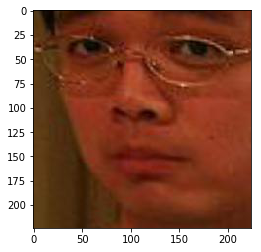

--------------------------------------------------
ChaLearn/images/train_1/001781.jpg



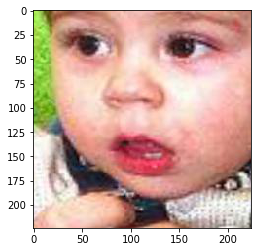

--------------------------------------------------
ChaLearn/images/train_1/001205.jpg



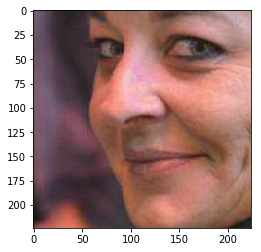

--------------------------------------------------
ChaLearn/images/train_1/000679.jpg



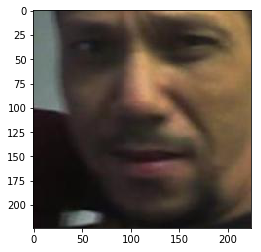

--------------------------------------------------
ChaLearn/images/train_1/001848.jpg



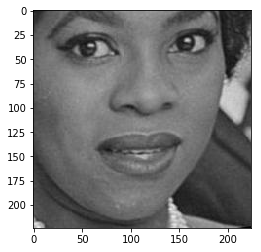

--------------------------------------------------
ChaLearn/images/train_1/001590.jpg



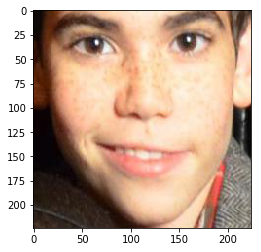

--------------------------------------------------
ChaLearn/images/train_1/000497.jpg



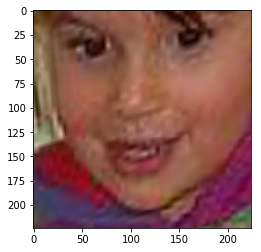

--------------------------------------------------
ChaLearn/images/train_1/001856.jpg



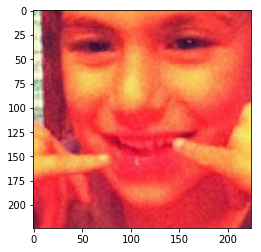

--------------------------------------------------
ChaLearn/images/train_1/001017.jpg



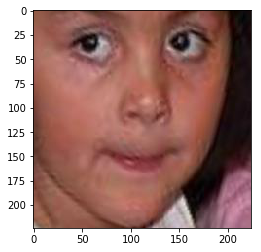

--------------------------------------------------
ChaLearn/images/train_1/000543.jpg



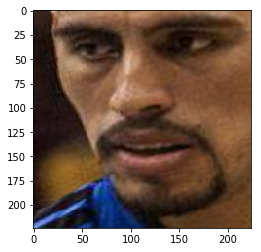

--------------------------------------------------
ChaLearn/images/train_1/001426.jpg



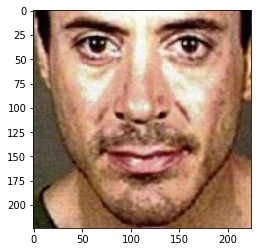

--------------------------------------------------
ChaLearn/images/train_1/001245.jpg



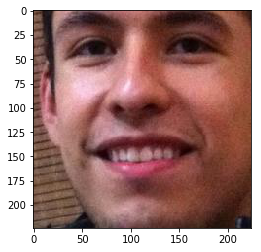

--------------------------------------------------
ChaLearn/images/train_1/001881.jpg



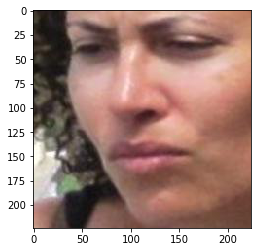

--------------------------------------------------
ChaLearn/images/train_1/000592.jpg



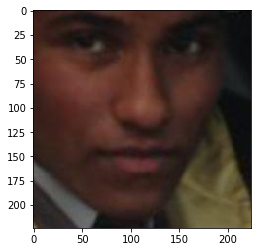

--------------------------------------------------
ChaLearn/images/train_1/000902.jpg



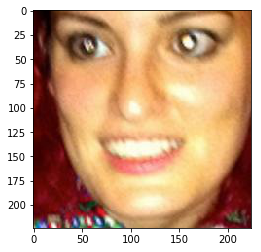

--------------------------------------------------
ChaLearn/images/train_1/000401.jpg



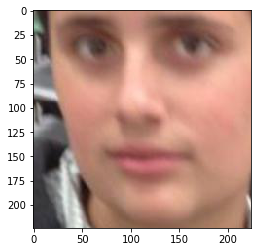

--------------------------------------------------
ChaLearn/images/train_1/000233.jpg



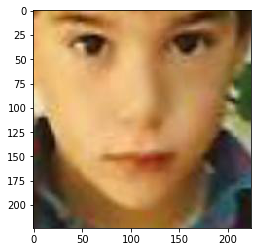

--------------------------------------------------
ChaLearn/images/train_1/001127.jpg



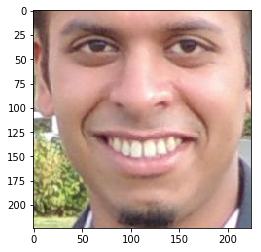

--------------------------------------------------
ChaLearn/images/train_1/001506.jpg



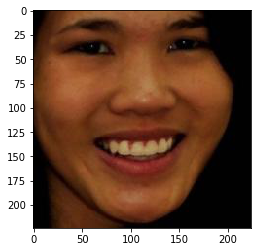

--------------------------------------------------
ChaLearn/images/train_1/001858.jpg



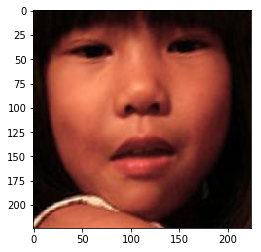

--------------------------------------------------
ChaLearn/images/train_1/001618.jpg



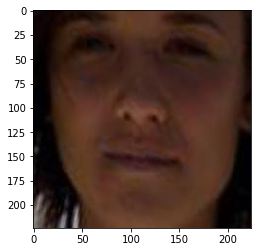

--------------------------------------------------
ChaLearn/images/train_1/001983.jpg



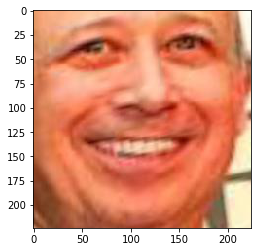

--------------------------------------------------
ChaLearn/images/train_1/000723.jpg



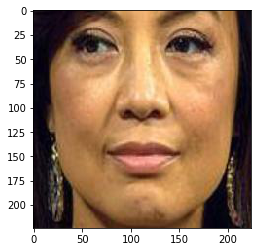

--------------------------------------------------
ChaLearn/images/train_1/000029.jpg



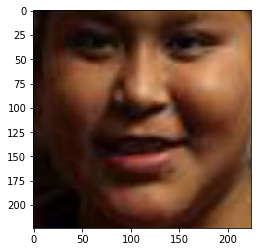

--------------------------------------------------
ChaLearn/images/train_1/000977.jpg



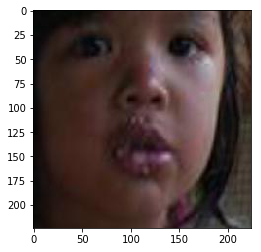

--------------------------------------------------
ChaLearn/images/train_1/000181.jpg



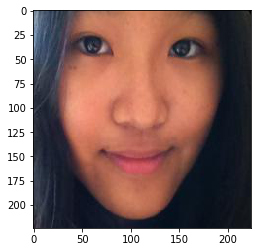

--------------------------------------------------
ChaLearn/images/train_1/000913.jpg



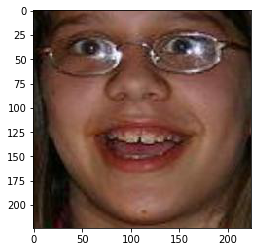

--------------------------------------------------
ChaLearn/images/train_1/000464.jpg



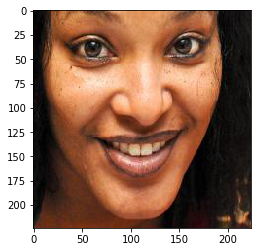

--------------------------------------------------
ChaLearn/images/train_1/001022.jpg



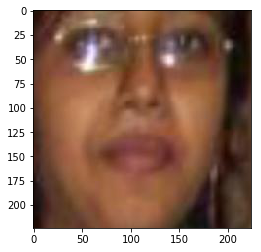

--------------------------------------------------
ChaLearn/images/train_1/001692.jpg



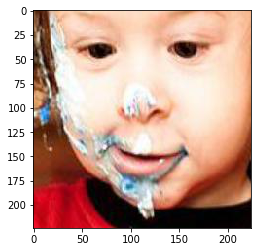

--------------------------------------------------
ChaLearn/images/train_1/000339.jpg



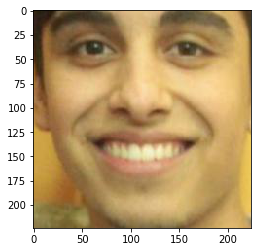

--------------------------------------------------
ChaLearn/images/train_1/000389.jpg



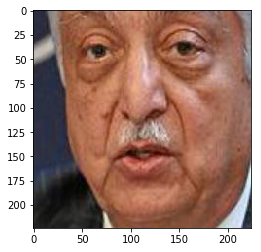

--------------------------------------------------
ChaLearn/images/train_1/001166.jpg



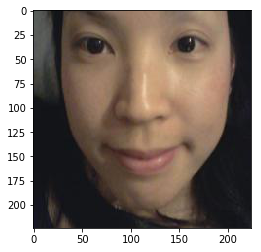

--------------------------------------------------
ChaLearn/images/train_1/000249.jpg



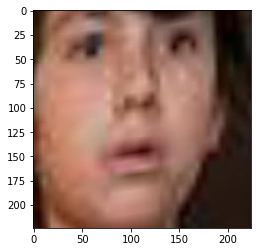

--------------------------------------------------
ChaLearn/images/train_1/000055.jpg



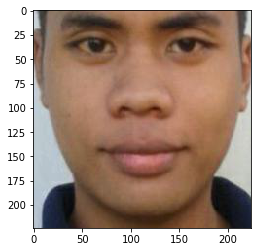

--------------------------------------------------
ChaLearn/images/train_1/000634.jpg



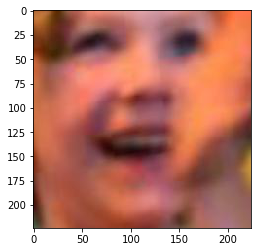

--------------------------------------------------
ChaLearn/images/train_1/001694.jpg



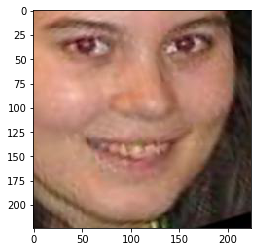

--------------------------------------------------
ChaLearn/images/train_1/001889.jpg



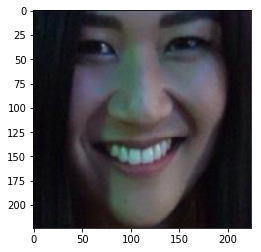

--------------------------------------------------
ChaLearn/images/train_1/000930.jpg



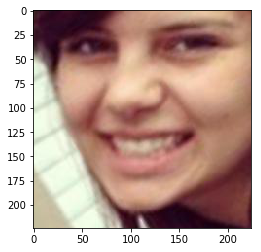

--------------------------------------------------
ChaLearn/images/train_1/000008.jpg



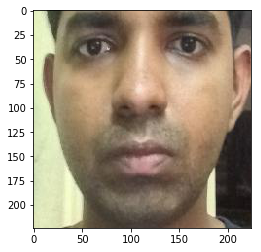

--------------------------------------------------
ChaLearn/images/train_1/000074.jpg



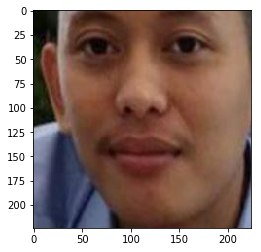

--------------------------------------------------
ChaLearn/images/train_1/000965.jpg



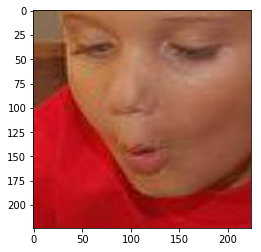

--------------------------------------------------
ChaLearn/images/train_1/001211.jpg



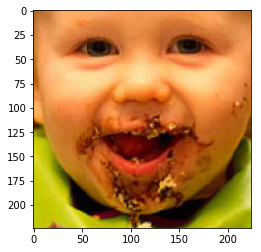

--------------------------------------------------
ChaLearn/images/train_1/001967.jpg



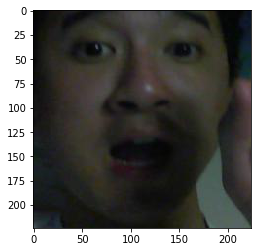

--------------------------------------------------
ChaLearn/images/train_1/001865.jpg



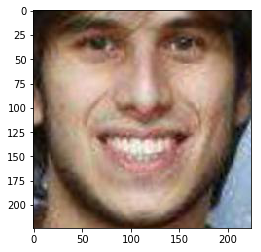

--------------------------------------------------
ChaLearn/images/train_1/000172.jpg



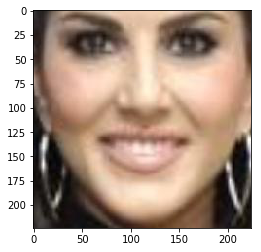

--------------------------------------------------
ChaLearn/images/train_1/001928.jpg



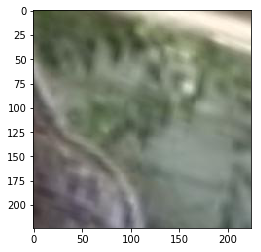

--------------------------------------------------
ChaLearn/images/train_1/002044.jpg



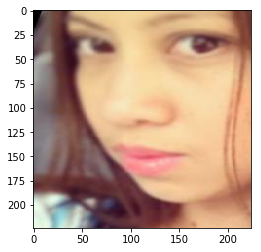

--------------------------------------------------
ChaLearn/images/train_1/001445.jpg



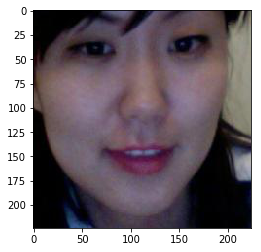

--------------------------------------------------
ChaLearn/images/train_1/000621.jpg



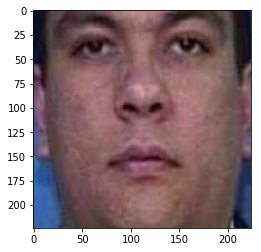

--------------------------------------------------
ChaLearn/images/train_1/001744.jpg



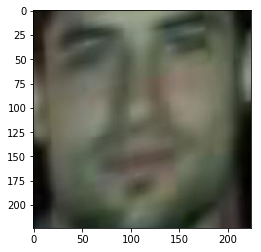

--------------------------------------------------
ChaLearn/images/train_1/001251.jpg



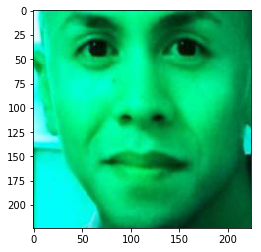

--------------------------------------------------
ChaLearn/images/train_1/001380.jpg



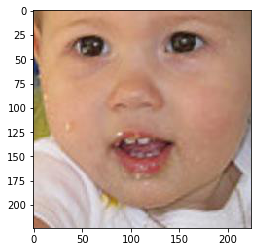

--------------------------------------------------
ChaLearn/images/train_1/000366.jpg



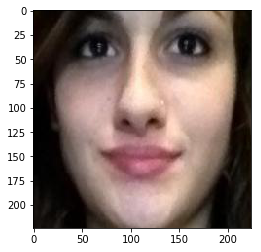

--------------------------------------------------
ChaLearn/images/train_1/000611.jpg



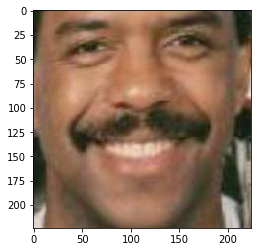

--------------------------------------------------
ChaLearn/images/train_1/001985.jpg



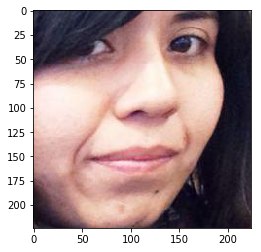

--------------------------------------------------
ChaLearn/images/train_1/000563.jpg



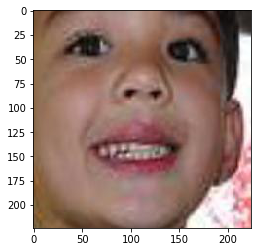

--------------------------------------------------
ChaLearn/images/train_1/000857.jpg



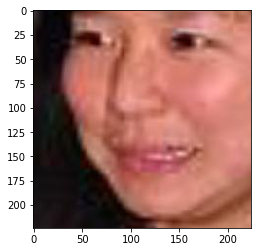

--------------------------------------------------
ChaLearn/images/train_1/000257.jpg



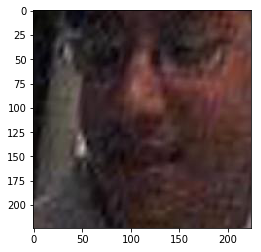

--------------------------------------------------
ChaLearn/images/train_1/000345.jpg



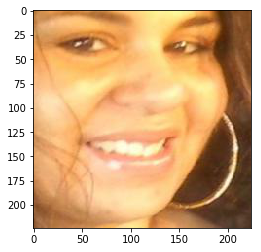

--------------------------------------------------
ChaLearn/images/train_1/001689.jpg



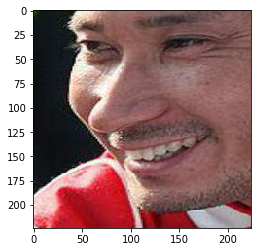

--------------------------------------------------
ChaLearn/images/train_1/001763.jpg



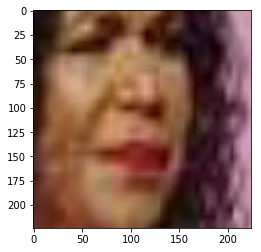

--------------------------------------------------
ChaLearn/images/train_2/003088.jpg



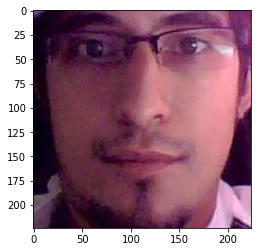

--------------------------------------------------
ChaLearn/images/train_2/002946.jpg



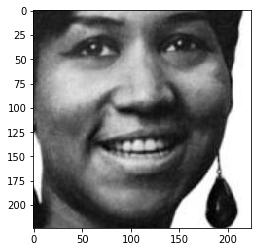

--------------------------------------------------
ChaLearn/images/train_2/003206.jpg



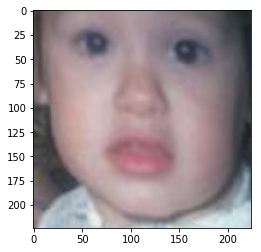

--------------------------------------------------
ChaLearn/images/train_2/004003.jpg



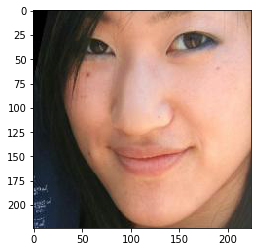

--------------------------------------------------
ChaLearn/images/train_2/003336.jpg



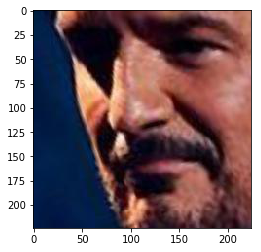

--------------------------------------------------
ChaLearn/images/train_2/002639.jpg



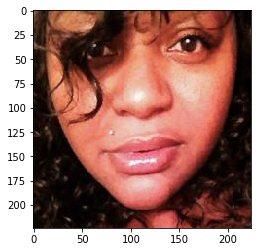

--------------------------------------------------
ChaLearn/images/train_2/003463.jpg



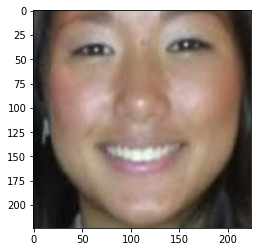

--------------------------------------------------
ChaLearn/images/train_2/002235.jpg



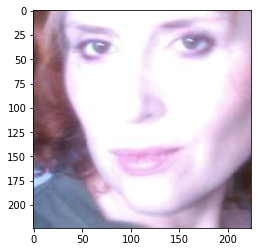

--------------------------------------------------
ChaLearn/images/train_2/004011.jpg



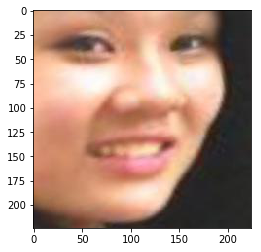

--------------------------------------------------
ChaLearn/images/train_2/003747.jpg



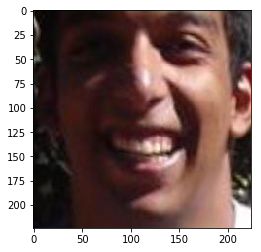

--------------------------------------------------
ChaLearn/images/train_2/004085.jpg



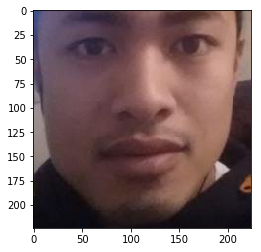

--------------------------------------------------
ChaLearn/images/train_2/002307.jpg



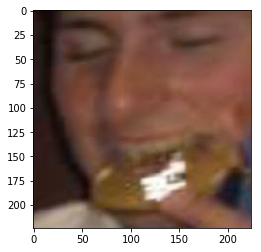

--------------------------------------------------
ChaLearn/images/train_2/003830.jpg



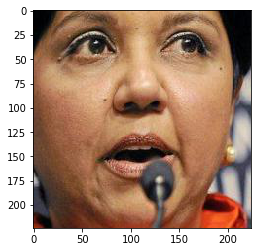

--------------------------------------------------
ChaLearn/images/train_2/003369.jpg



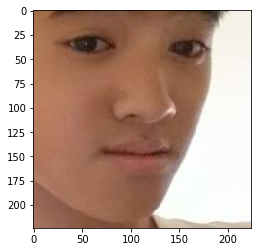

--------------------------------------------------
ChaLearn/images/train_2/002832.jpg



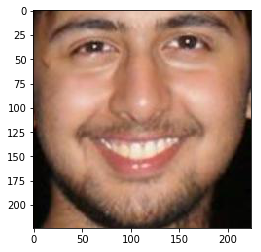

--------------------------------------------------
ChaLearn/images/train_2/003538.jpg



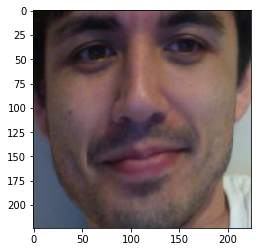

--------------------------------------------------
ChaLearn/images/train_2/003005.jpg



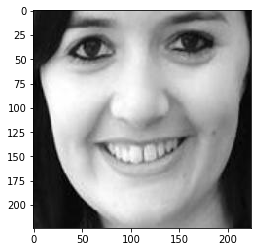

--------------------------------------------------
ChaLearn/images/train_2/004033.jpg



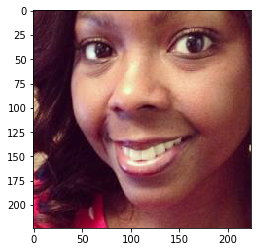

--------------------------------------------------
ChaLearn/images/train_2/003354.jpg



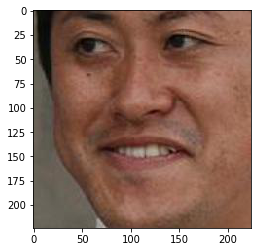

--------------------------------------------------
ChaLearn/images/train_2/003456.jpg



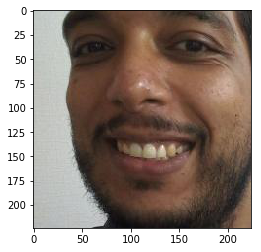

--------------------------------------------------
ChaLearn/images/train_2/003754.jpg



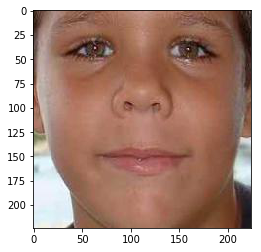

--------------------------------------------------
ChaLearn/images/train_2/003068.jpg



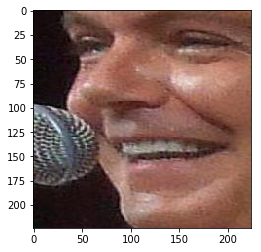

--------------------------------------------------
ChaLearn/images/train_2/003634.jpg



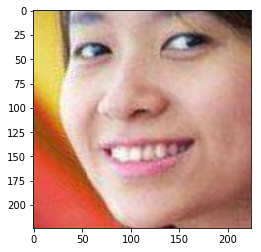

--------------------------------------------------
ChaLearn/images/train_2/002784.jpg



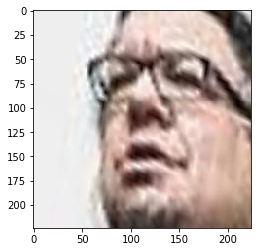

--------------------------------------------------
ChaLearn/images/train_2/002296.jpg



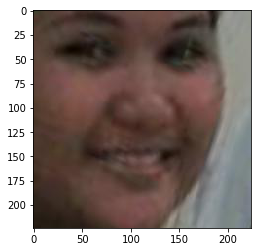

--------------------------------------------------
ChaLearn/images/train_2/002657.jpg



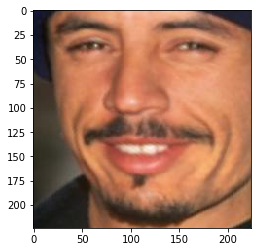

--------------------------------------------------
ChaLearn/images/train_2/003827.jpg



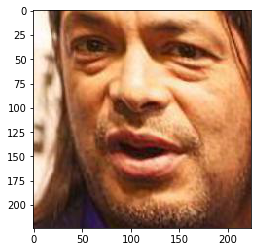

--------------------------------------------------
ChaLearn/images/train_2/003265.jpg



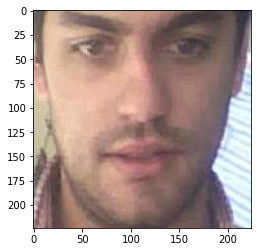

--------------------------------------------------
ChaLearn/images/train_2/002669.jpg



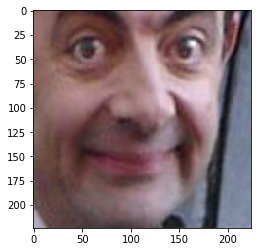

--------------------------------------------------
ChaLearn/images/train_2/002422.jpg



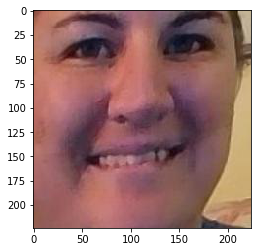

--------------------------------------------------
ChaLearn/images/train_2/002513.jpg



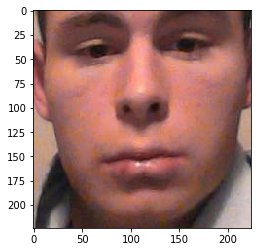

--------------------------------------------------
ChaLearn/images/train_2/002211.jpg



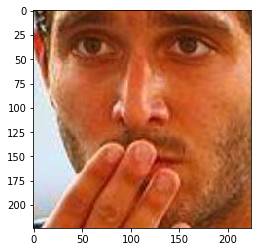

--------------------------------------------------
ChaLearn/images/train_2/003806.jpg



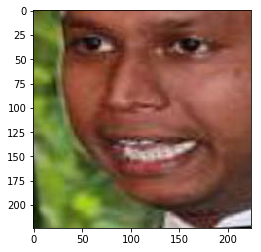

--------------------------------------------------
ChaLearn/images/train_2/004000.jpg



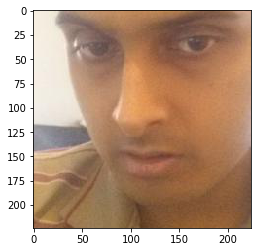

--------------------------------------------------
ChaLearn/images/train_2/003442.jpg



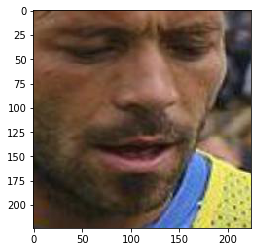

--------------------------------------------------
ChaLearn/images/train_2/002119.jpg



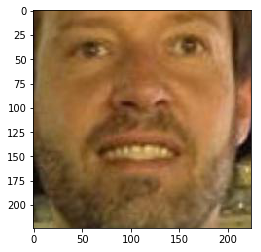

--------------------------------------------------
ChaLearn/images/train_2/002663.jpg



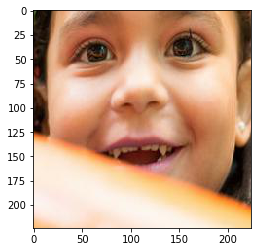

--------------------------------------------------
ChaLearn/images/train_2/003646.jpg



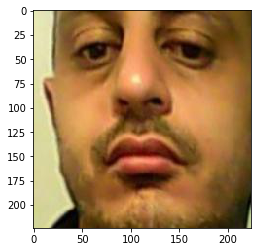

--------------------------------------------------
ChaLearn/images/train_2/003874.jpg



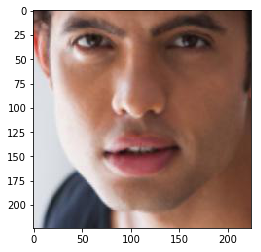

--------------------------------------------------
ChaLearn/images/train_2/002768.jpg



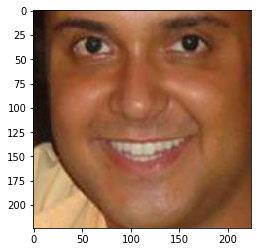

--------------------------------------------------
ChaLearn/images/train_2/002382.jpg



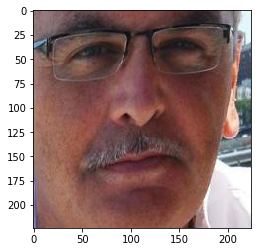

--------------------------------------------------
ChaLearn/images/train_2/003843.jpg



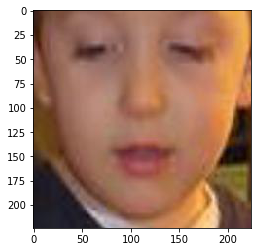

--------------------------------------------------
ChaLearn/images/train_2/002357.jpg



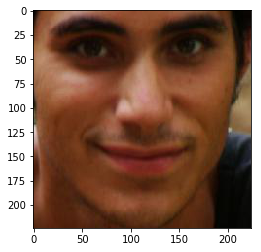

--------------------------------------------------
ChaLearn/images/train_2/003711.jpg



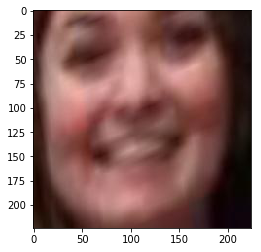

--------------------------------------------------
ChaLearn/images/train_2/003842.jpg



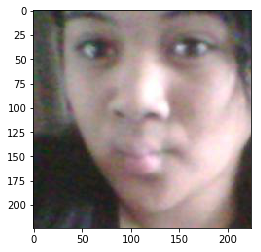

--------------------------------------------------
ChaLearn/images/train_2/003514.jpg



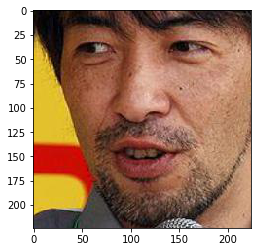

--------------------------------------------------
ChaLearn/images/train_2/002074.jpg



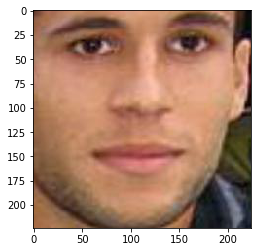

--------------------------------------------------
ChaLearn/images/train_2/002847.jpg



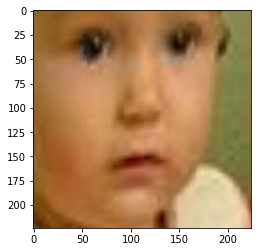

--------------------------------------------------
ChaLearn/images/train_2/003840.jpg



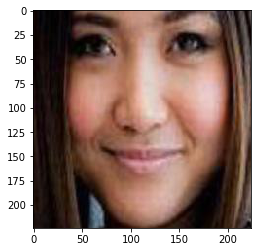

--------------------------------------------------
ChaLearn/images/train_2/002361.jpg



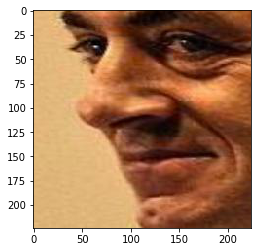

--------------------------------------------------
ChaLearn/images/train_2/003038.jpg



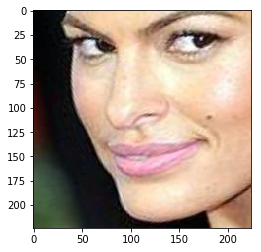

--------------------------------------------------
ChaLearn/images/train_2/002704.jpg



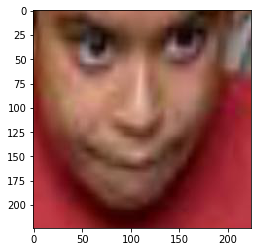

--------------------------------------------------
ChaLearn/images/train_2/002331.jpg



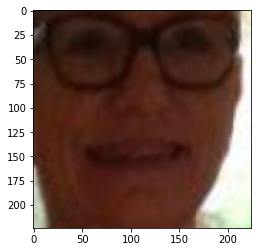

--------------------------------------------------
ChaLearn/images/train_2/002158.jpg



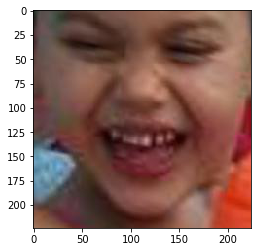

--------------------------------------------------
ChaLearn/images/train_2/002143.jpg



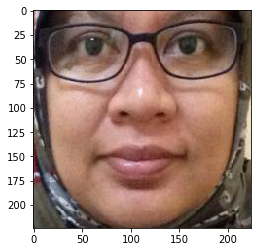

--------------------------------------------------
ChaLearn/images/train_2/003700.jpg



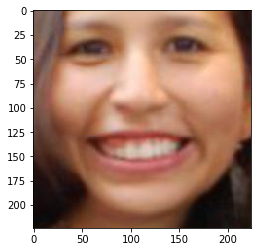

--------------------------------------------------
ChaLearn/images/train_2/003384.jpg



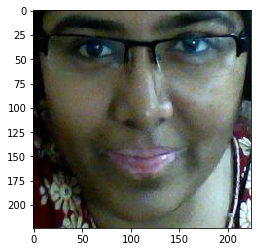

--------------------------------------------------
ChaLearn/images/train_2/002914.jpg



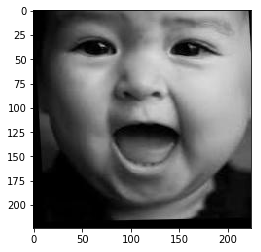

--------------------------------------------------
ChaLearn/images/train_2/004014.jpg



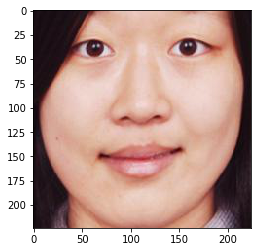

--------------------------------------------------
ChaLearn/images/train_2/002502.jpg



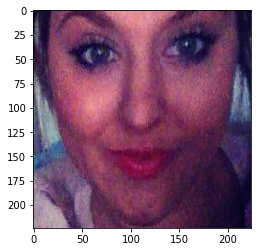

--------------------------------------------------
ChaLearn/images/train_2/002426.jpg



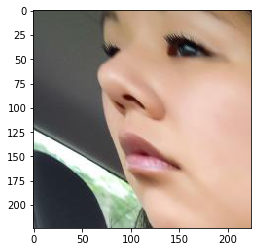

--------------------------------------------------
ChaLearn/images/train_2/002497.jpg



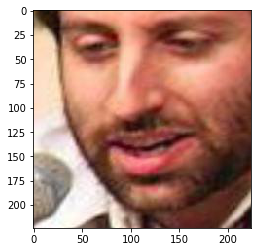

--------------------------------------------------
ChaLearn/images/train_2/004061.jpg



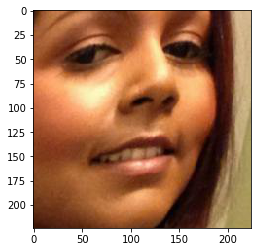

--------------------------------------------------
ChaLearn/images/train_2/002699.jpg



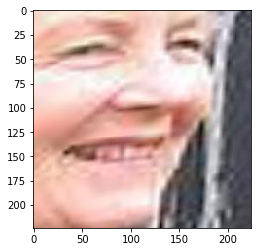

--------------------------------------------------
ChaLearn/images/train_2/002241.jpg



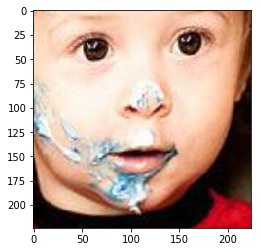

--------------------------------------------------
ChaLearn/images/train_2/003894.jpg



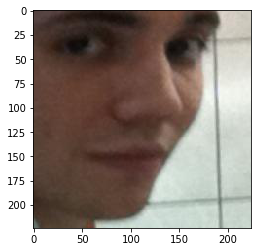

--------------------------------------------------
ChaLearn/images/train_2/004016.jpg



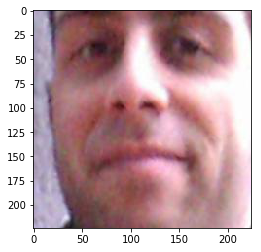

--------------------------------------------------
ChaLearn/images/train_2/003031.jpg



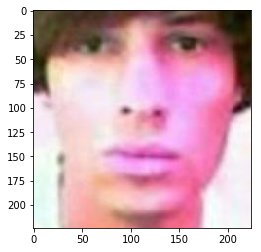

--------------------------------------------------
ChaLearn/images/train_2/002563.jpg



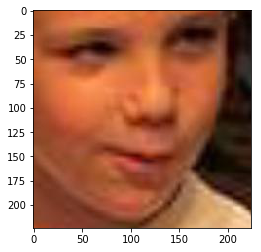

--------------------------------------------------
ChaLearn/images/train_2/003101.jpg



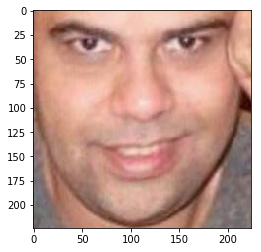

--------------------------------------------------
ChaLearn/images/train_2/003015.jpg



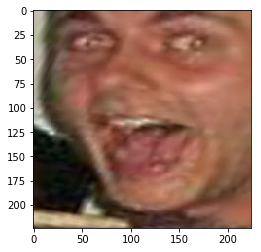

--------------------------------------------------
ChaLearn/images/train_2/002560.jpg



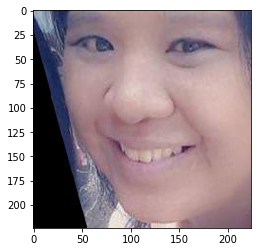

--------------------------------------------------
ChaLearn/images/train_2/004062.jpg



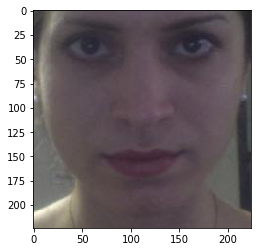

--------------------------------------------------
ChaLearn/images/train_2/003232.jpg



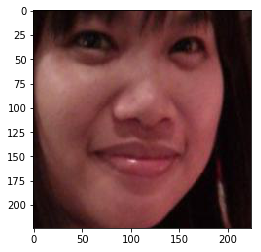

--------------------------------------------------
ChaLearn/images/train_2/002175.jpg



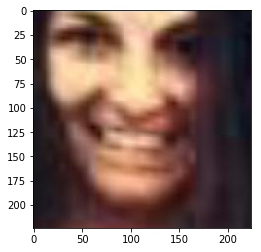

--------------------------------------------------
ChaLearn/images/train_2/003873.jpg



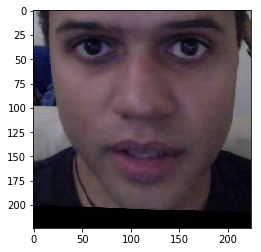

--------------------------------------------------
ChaLearn/images/train_2/004079.jpg



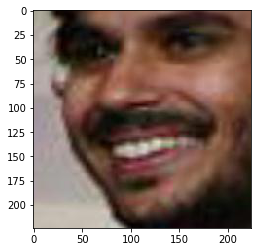

--------------------------------------------------
ChaLearn/images/train_2/002105.jpg



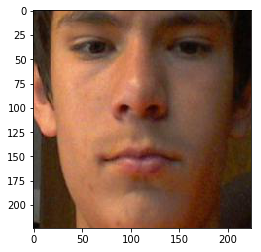

--------------------------------------------------
ChaLearn/images/train_2/002990.jpg



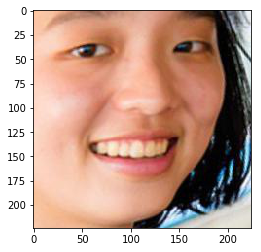

--------------------------------------------------
ChaLearn/images/train_2/002728.jpg



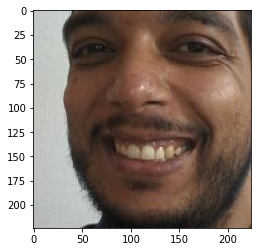

--------------------------------------------------
ChaLearn/images/train_2/002303.jpg



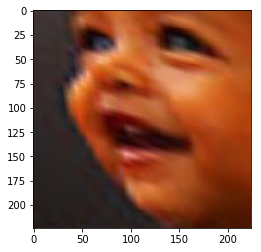

--------------------------------------------------
ChaLearn/images/train_2/003543.jpg



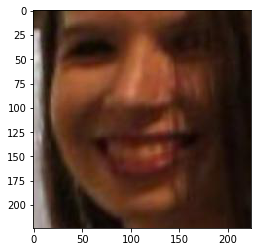

--------------------------------------------------
ChaLearn/images/train_2/003071.jpg



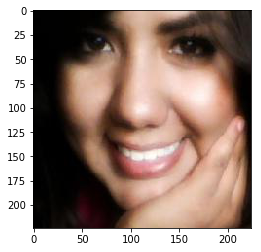

--------------------------------------------------
ChaLearn/images/train_2/003663.jpg



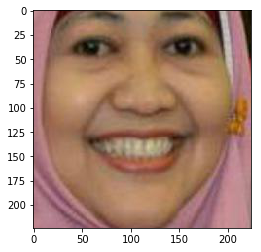

--------------------------------------------------
ChaLearn/images/train_2/003887.jpg



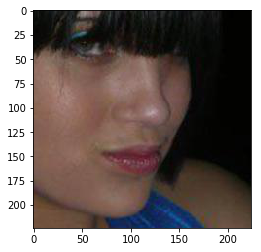

--------------------------------------------------
ChaLearn/images/train_2/002779.jpg



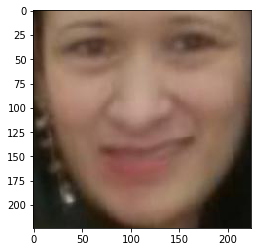

--------------------------------------------------
ChaLearn/images/train_2/004076.jpg



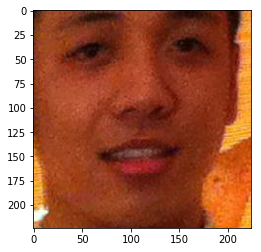

--------------------------------------------------
ChaLearn/images/train_2/002289.jpg



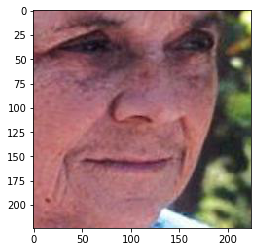

--------------------------------------------------
ChaLearn/images/train_2/002135.jpg



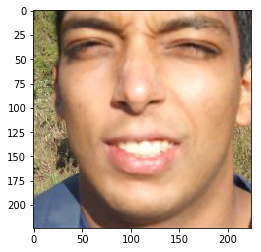

--------------------------------------------------
ChaLearn/images/train_2/003277.jpg



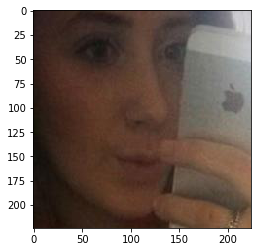

--------------------------------------------------
ChaLearn/images/train_2/002901.jpg



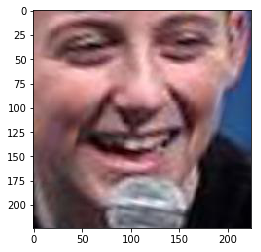

--------------------------------------------------
ChaLearn/images/train_2/002753.jpg



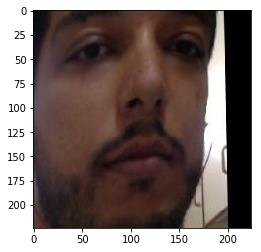

--------------------------------------------------
ChaLearn/images/train_2/003119.jpg



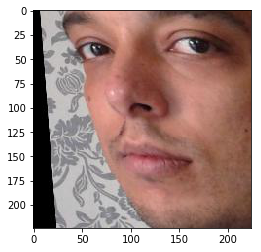

--------------------------------------------------
ChaLearn/images/train_2/003099.jpg



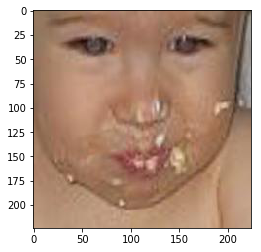

--------------------------------------------------
ChaLearn/images/train_2/003495.jpg



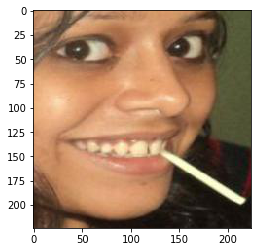

--------------------------------------------------
ChaLearn/images/train_2/002750.jpg



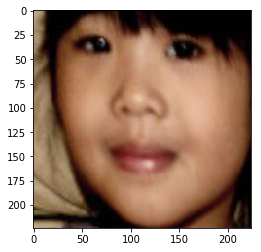

--------------------------------------------------
ChaLearn/images/train_2/003709.jpg



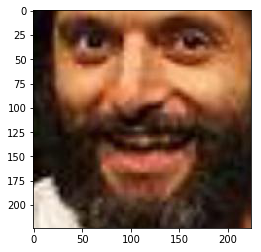

--------------------------------------------------
ChaLearn/images/train_2/002407.jpg



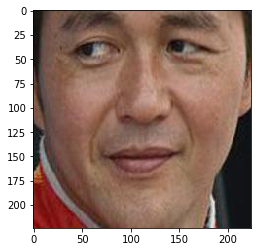

--------------------------------------------------
ChaLearn/images/train_2/003273.jpg



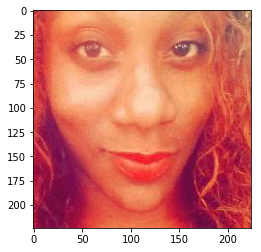

--------------------------------------------------
ChaLearn/images/train_2/003790.jpg



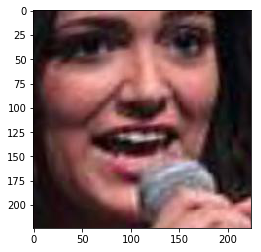

--------------------------------------------------
ChaLearn/images/train_2/002937.jpg



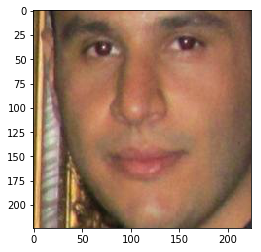

--------------------------------------------------
ChaLearn/images/train_2/003518.jpg



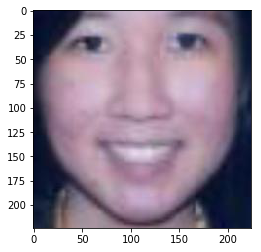

--------------------------------------------------
ChaLearn/images/train_2/003161.jpg



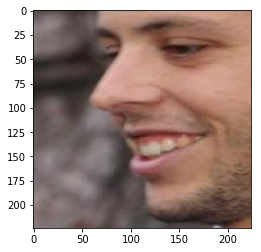

--------------------------------------------------
ChaLearn/images/train_2/003811.jpg



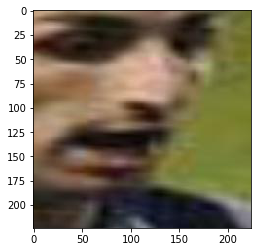

--------------------------------------------------
ChaLearn/images/train_2/003743.jpg



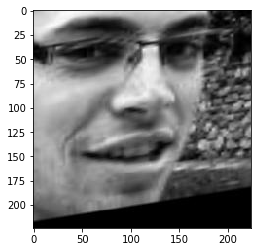

--------------------------------------------------
ChaLearn/images/train_2/002559.jpg



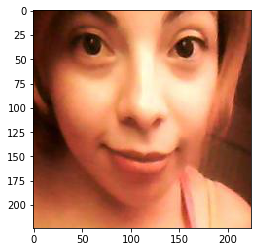

--------------------------------------------------
ChaLearn/images/valid/004745.jpg



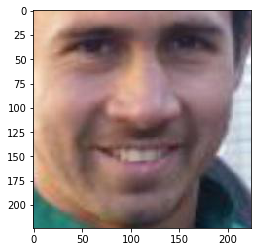

--------------------------------------------------
ChaLearn/images/valid/005603.jpg



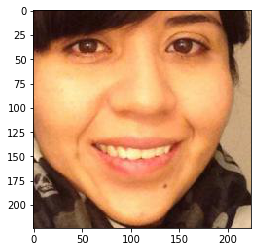

--------------------------------------------------
ChaLearn/images/valid/004435.jpg



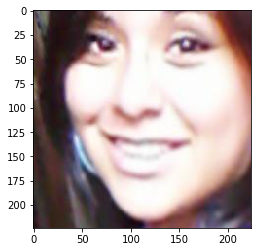

--------------------------------------------------
ChaLearn/images/valid/005484.jpg



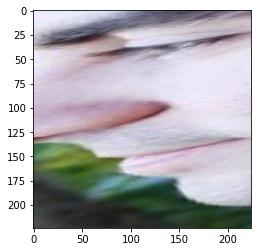

--------------------------------------------------
ChaLearn/images/valid/005509.jpg



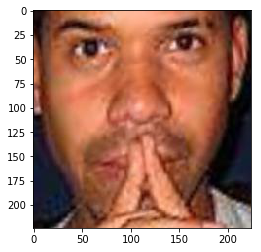

--------------------------------------------------
ChaLearn/images/valid/004612.jpg



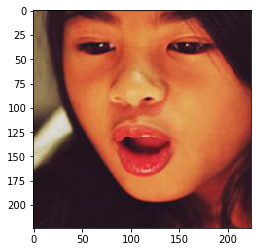

--------------------------------------------------
ChaLearn/images/valid/004221.jpg



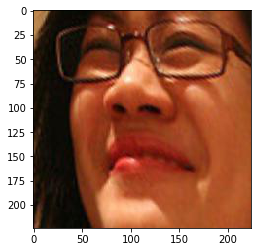

--------------------------------------------------
ChaLearn/images/valid/004269.jpg



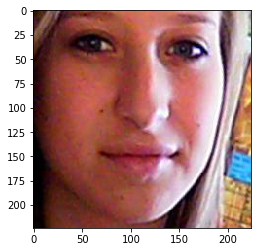

--------------------------------------------------
ChaLearn/images/valid/004836.jpg



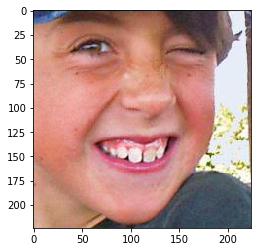

--------------------------------------------------
ChaLearn/images/valid/004236.jpg



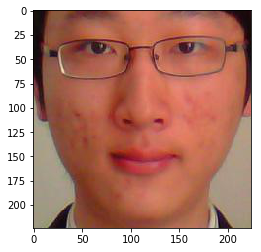

--------------------------------------------------
ChaLearn/images/valid/004859.jpg



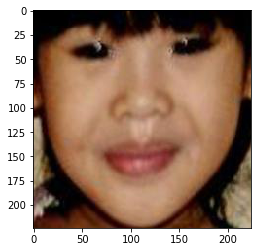

--------------------------------------------------
ChaLearn/images/valid/004768.jpg



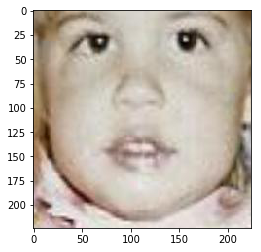

--------------------------------------------------
ChaLearn/images/valid/004265.jpg



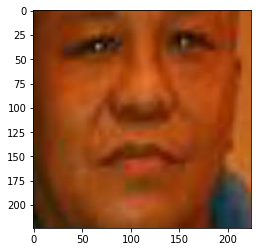

--------------------------------------------------
ChaLearn/images/valid/005566.jpg



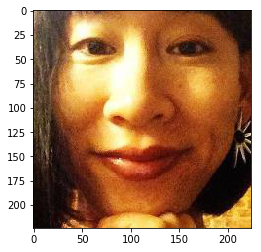

--------------------------------------------------
ChaLearn/images/valid/004599.jpg



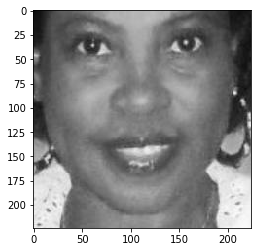

--------------------------------------------------
ChaLearn/images/valid/005541.jpg



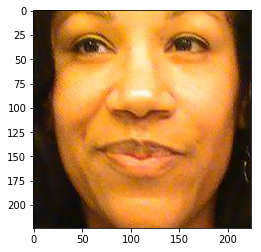

--------------------------------------------------
ChaLearn/images/valid/005028.jpg



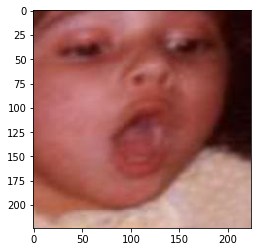

--------------------------------------------------
ChaLearn/images/valid/004655.jpg



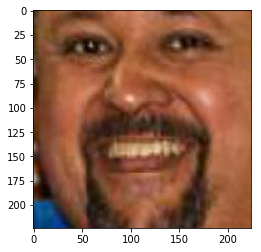

--------------------------------------------------
ChaLearn/images/valid/005490.jpg



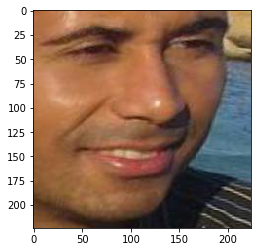

--------------------------------------------------
ChaLearn/images/valid/005039.jpg



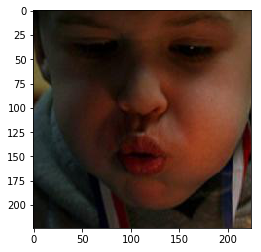

--------------------------------------------------
ChaLearn/images/valid/004659.jpg



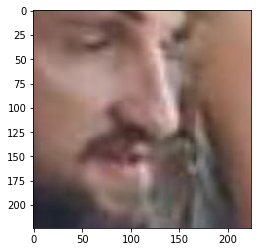

--------------------------------------------------
ChaLearn/images/valid/004390.jpg



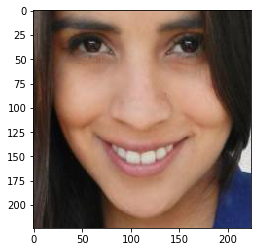

--------------------------------------------------
ChaLearn/images/valid/004964.jpg



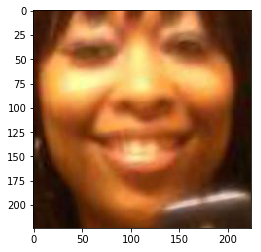

--------------------------------------------------
ChaLearn/images/valid/005453.jpg



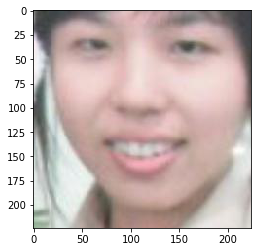

--------------------------------------------------
ChaLearn/images/valid/004347.jpg



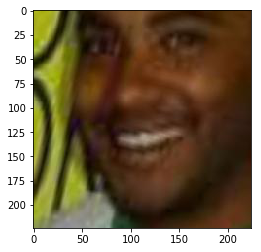

--------------------------------------------------
ChaLearn/images/valid/005232.jpg



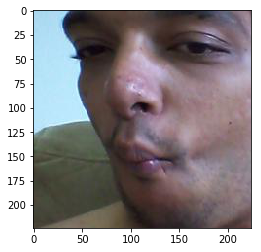

--------------------------------------------------
ChaLearn/images/valid/004726.jpg



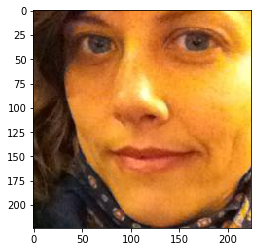

--------------------------------------------------
ChaLearn/images/valid/005052.jpg



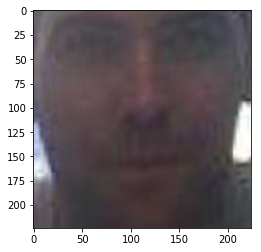

--------------------------------------------------
ChaLearn/images/valid/005377.jpg



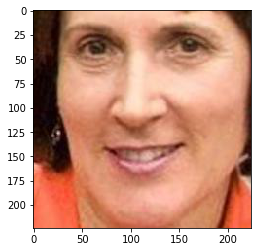

--------------------------------------------------
ChaLearn/images/valid/004876.jpg



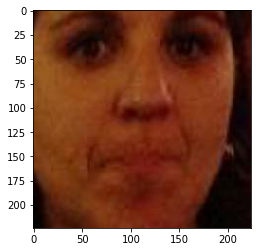

--------------------------------------------------
ChaLearn/images/valid/005273.jpg



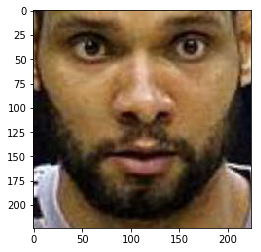

--------------------------------------------------
ChaLearn/images/valid/005254.jpg



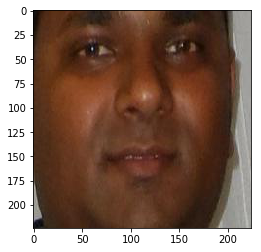

--------------------------------------------------
ChaLearn/images/valid/005013.jpg



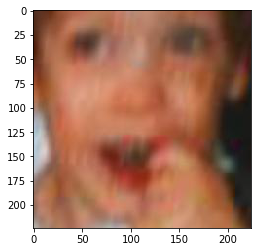

--------------------------------------------------
ChaLearn/images/valid/004225.jpg



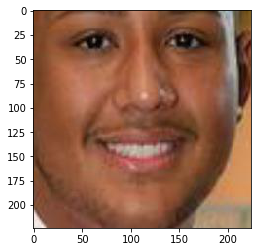

--------------------------------------------------
ChaLearn/images/valid/005478.jpg



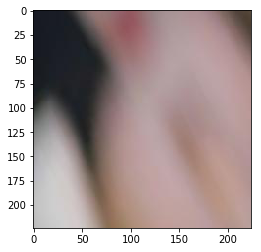

--------------------------------------------------
ChaLearn/images/valid/004440.jpg



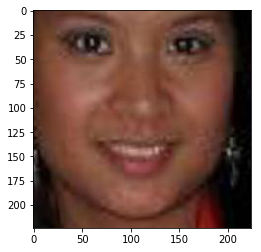

--------------------------------------------------
ChaLearn/images/valid/004348.jpg



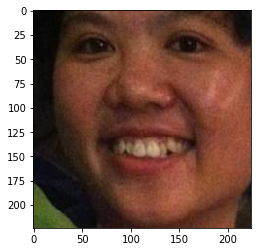

--------------------------------------------------
ChaLearn/images/valid/004582.jpg



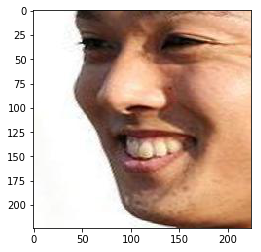

--------------------------------------------------
ChaLearn/images/valid/004946.jpg



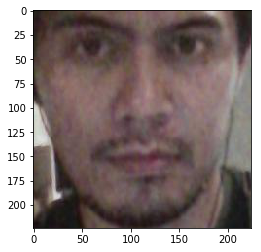

--------------------------------------------------
ChaLearn/images/valid/004349.jpg



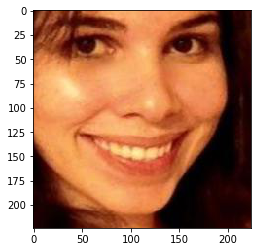

--------------------------------------------------
ChaLearn/images/valid/005185.jpg



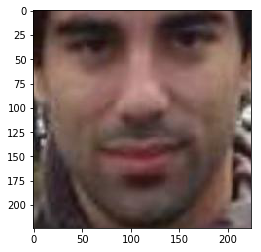

--------------------------------------------------
ChaLearn/images/valid/005432.jpg



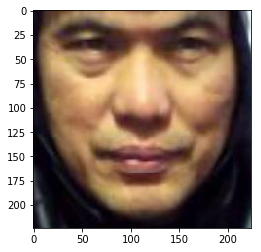

--------------------------------------------------
ChaLearn/images/valid/004639.jpg



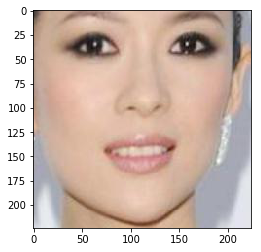

--------------------------------------------------
ChaLearn/images/valid/004536.jpg



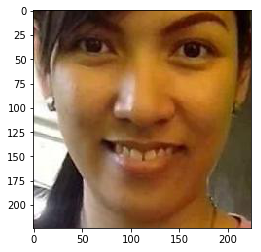

--------------------------------------------------
ChaLearn/images/valid/004517.jpg



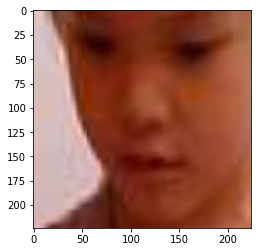

--------------------------------------------------
ChaLearn/images/valid/005521.jpg



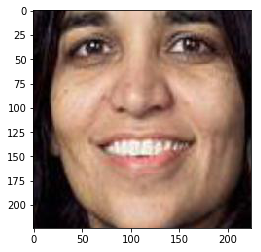

--------------------------------------------------
ChaLearn/images/valid/004812.jpg



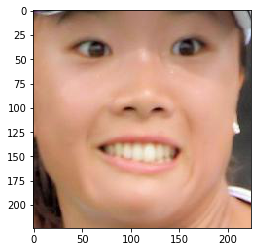

--------------------------------------------------
ChaLearn/images/valid/005612.jpg



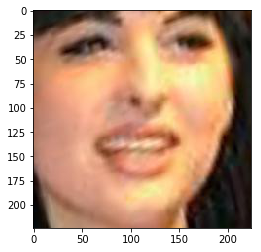

--------------------------------------------------
ChaLearn/images/valid/004723.jpg



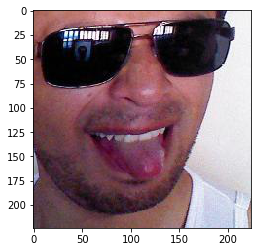

--------------------------------------------------
ChaLearn/images/valid/004929.jpg



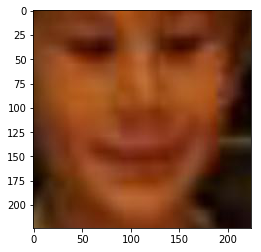

--------------------------------------------------
ChaLearn/images/valid/005387.jpg



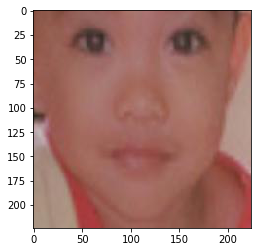

--------------------------------------------------
ChaLearn/images/valid/004845.jpg



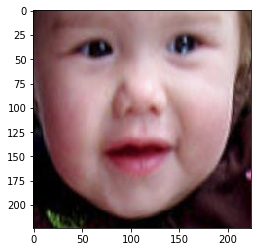

--------------------------------------------------
ChaLearn/images/valid/004483.jpg



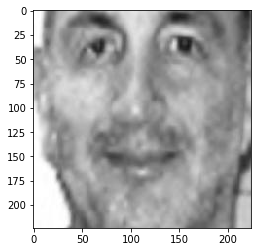

--------------------------------------------------
ChaLearn/images/valid/004372.jpg



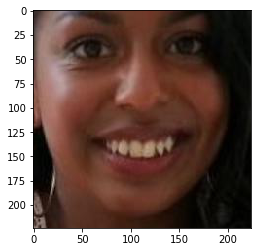

--------------------------------------------------
ChaLearn/images/valid/004395.jpg



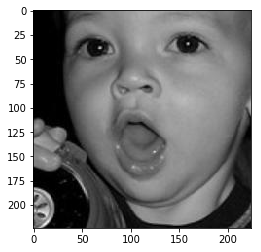

--------------------------------------------------
ChaLearn/images/valid/004918.jpg



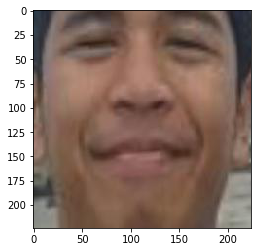

--------------------------------------------------
ChaLearn/images/valid/005017.jpg



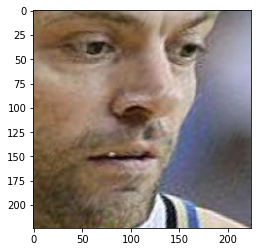

--------------------------------------------------
ChaLearn/images/valid/004858.jpg



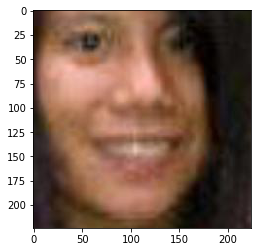

--------------------------------------------------


In [2]:
from matplotlib import pyplot as plt
from skimage import io

%matplotlib inline

with open('chalearn_uncertain.txt', 'r') as f:
    file_paths = f.readlines()
    for file_path in file_paths:
        image = io.imread(file_path.strip())
        print(file_path)
        plt.imshow(image)
        plt.show()
        print('-' * 50)